# Clustering of IMU and Odometry Data from TurtleBot3
### By Jacob Laframboise, Jack Demeter
Here we take in a dataset of imu data recorded from the TurtleBot3 Waffle Pi driving on 2 different surfaces at 4 different speeds each, and use K-means clustering to assign each data point to a cluster. Then we use PCA to visualize this high (118) dimension data in 2 or 3 dimensions. Matplotlib is used to plot in 2D, and Plotly is used to plot in 3D interactively, so we can better see the clusters. 

This notebook picks up from where the Python file PreprocessForKmeans.py leaves off, taking in the cleaned dataset. 

In [107]:
# imports
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer

import plotly as ply
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
%matplotlib notebook

pd.set_option('display.max_columns', 120)
pd.set_option('display.max_rows', 80)

## Data Pre-Processing
#### We load in individual csv files collected from Rosbag on TurtleBot3 with ROS.

In [108]:
dataFolder = r"C:\Users\jaker\Documents\Experiment3Data-2019-11-21"

dataFiles = [
    r"gMitTile_s15_t8.csv",
    r"gMitTile_s15_t9.csv",
    r"gMitTile_s15_t10.csv",
    r"gTurf_s15_t3.csv",
    r"gTurf_s15_t4.csv",
    r"gTurf_s15_t5.csv",
    r"gTurf_s15_t6.csv",
    r"gTurf_s15_t7.csv",
    r"gTurf_s15_t8.csv",
    r"gTurf_s15_t9.csv",
    r"gTurf_s15_t10.csv",
    r"gArcTile_s15_t3.csv",
    r"gArcTile_s15_t4.csv",
    r"gArcTile_s15_t5.csv",
    r"gArcTile_s15_t6.csv",
    r"gArcTile_s15_t7.csv",
    r"gArcTile_s15_t8.csv",
    r"gArcTile_s15_t9.csv",
    r"gArcTile_s15_t10.csv",
    r"gCarp_s15_t3.csv",
    r"gCarp_s15_t4.csv",
    r"gCarp_s15_t5.csv",
    r"gCarp_s15_t6.csv",
    r"gCarp_s15_t7.csv",
    r"gCarp_s15_t8.csv",
    r"gCarp_s15_t9.csv",
    r"gCarp_s15_t10.csv",
    r"gMitTile_s15_t3.csv",
    r"gMitTile_s15_t4.csv",
    r"gMitTile_s15_t5.csv",
    r"gMitTile_s15_t6.csv",
    r"gMitTile_s15_t7.csv"
]

savePath = "Data-32Series-Delta30-Squared.csv"

In [109]:
""" 
For each data file we:
adjust the index, 
interpolate NaN values,
drop remaining NaN values, 
drop some empty columns.

We then augment the feature space with delta columns, 
and with polynomial columns,
and label the columns with terrain, speed, and trial number
"""
for i in range(len(dataFiles)):
    terrain = dataFiles[i].split('_')[0][1:]
    speed = dataFiles[i].split('_s')[1][:2]
    trial = dataFiles[i].split('_t')[1][0]

    df = pd.read_csv(os.path.join(dataFolder, dataFiles[i]))
    df = df.rename(columns={'Unnamed: 0': 'Seq'})
    df = df.set_index('Seq')

    #print(df.isnull().sum().sum())
    df = df.interpolate(method='polynomial', order=1)
    #print(df.isnull().sum().sum())

    df = df.dropna()
    #print(df.isnull().sum().sum())
    df = df.reset_index().drop(columns=['Seq'])
    
    df['OdomPosX'] = df['OdomPosX'] - df['OdomPosX'].loc[0]
    df['OdomPosY'] = df['OdomPosY'] - df['OdomPosY'].loc[0]

    df = df.drop(columns=['OdomPosZ', 'OdomOrientX', 'OdomOrientY', 'OdomLinY', 'OdomLinZ', 'OdomAngX', 'OdomAngY'])
    df['OdomPosXY'] = np.sqrt(df.OdomPosX**2 + df.OdomPosY**2)
    df = df.drop(columns=['OdomPosY', 'OdomPosX'])
    
    for c in df.columns.tolist():
        print(c)
    
    order=2
    
    dList = range(1, 302, 20)
    # dList = [2,4,8,16,32,64]
    for col in df.columns.tolist():
        if col!='Sensor':
            for d in dList:
                df[col+'Delta{}'.format(d)] = df[col].diff(d)
                if order>1:
                    for p in range(2, order+1):
                        df[col+'Delta{}Exp{}'.format(d, p)] = df[col+'Delta{}'.format(d)]**p
                        #print('Added ' + col +'Delta{}'.format(d))
        else:
            pass

    df = df.iloc[max(dList):].reset_index().drop(columns=['index'])
    df = df.drop(columns=['Sensor', 'Time'])
    df['Speed']=int(speed)
    df['Terrain']=terrain
    df['Trial']=int(trial)

    if i==0:
        mainDf = df.copy(deep=True)
    else:
        mainDf = pd.concat([mainDf, df], axis=0, sort=False)
    print("Added {} of size {} to mainDf. ".format(dataFiles[i], df.shape))
    print("Data series completed: {}/{}".format(i+1,len(dataFiles)))
    print("MainDf is now size {}".format(mainDf.shape))
    print('\n')

Time
OdomOrientZ
OdomOrientW
OdomLinX
OdomAngZ
Sensor
ImuOrientX
ImuOrientY
ImuOrientZ
ImuOrientW
ImuAngVelX
ImuAngVelY
ImuAngVelZ
ImuAccelX
ImuAccelY
ImuAccelZ
OdomPosXY
Added gMitTile_s15_t8.csv of size (3530, 530) to mainDf. 
Data series completed: 1/32
MainDf is now size (3530, 530)


Time
OdomOrientZ
OdomOrientW
OdomLinX
OdomAngZ
Sensor
ImuOrientX
ImuOrientY
ImuOrientZ
ImuOrientW
ImuAngVelX
ImuAngVelY
ImuAngVelZ
ImuAccelX
ImuAccelY
ImuAccelZ
OdomPosXY
Added gMitTile_s15_t9.csv of size (4030, 530) to mainDf. 
Data series completed: 2/32
MainDf is now size (7560, 530)


Time
OdomOrientZ
OdomOrientW
OdomLinX
OdomAngZ
Sensor
ImuOrientX
ImuOrientY
ImuOrientZ
ImuOrientW
ImuAngVelX
ImuAngVelY
ImuAngVelZ
ImuAccelX
ImuAccelY
ImuAccelZ
OdomPosXY
Added gMitTile_s15_t10.csv of size (4552, 530) to mainDf. 
Data series completed: 3/32
MainDf is now size (12112, 530)


Time
OdomOrientZ
OdomOrientW
OdomLinX
OdomAngZ
Sensor
ImuOrientX
ImuOrientY
ImuOrientZ
ImuOrientW
ImuAngVelX
ImuAngVelY
ImuAngVe

Added gMitTile_s15_t4.csv of size (4423, 530) to mainDf. 
Data series completed: 29/32
MainDf is now size (133485, 530)


Time
OdomOrientZ
OdomOrientW
OdomLinX
OdomAngZ
Sensor
ImuOrientX
ImuOrientY
ImuOrientZ
ImuOrientW
ImuAngVelX
ImuAngVelY
ImuAngVelZ
ImuAccelX
ImuAccelY
ImuAccelZ
OdomPosXY
Added gMitTile_s15_t5.csv of size (3578, 530) to mainDf. 
Data series completed: 30/32
MainDf is now size (137063, 530)


Time
OdomOrientZ
OdomOrientW
OdomLinX
OdomAngZ
Sensor
ImuOrientX
ImuOrientY
ImuOrientZ
ImuOrientW
ImuAngVelX
ImuAngVelY
ImuAngVelZ
ImuAccelX
ImuAccelY
ImuAccelZ
OdomPosXY
Added gMitTile_s15_t6.csv of size (4407, 530) to mainDf. 
Data series completed: 31/32
MainDf is now size (141470, 530)


Time
OdomOrientZ
OdomOrientW
OdomLinX
OdomAngZ
Sensor
ImuOrientX
ImuOrientY
ImuOrientZ
ImuOrientW
ImuAngVelX
ImuAngVelY
ImuAngVelZ
ImuAccelX
ImuAccelY
ImuAccelZ
OdomPosXY
Added gMitTile_s15_t7.csv of size (3883, 530) to mainDf. 
Data series completed: 32/32
MainDf is now size (145353, 530)



In [110]:
# avoid reloading dataset when working
df = mainDf.copy(deep=True)

In [111]:
df.head(10)

,OdomOrientZ,OdomOrientW,OdomLinX,OdomAngZ,ImuOrientX,ImuOrientY,ImuOrientZ,ImuOrientW,ImuAngVelX,ImuAngVelY,ImuAngVelZ,ImuAccelX,ImuAccelY,ImuAccelZ,OdomPosXY,TimeDelta1,TimeDelta1Exp2,TimeDelta21,TimeDelta21Exp2,TimeDelta41,TimeDelta41Exp2,TimeDelta61,TimeDelta61Exp2,TimeDelta81,TimeDelta81Exp2,TimeDelta101,TimeDelta101Exp2,TimeDelta121,TimeDelta121Exp2,TimeDelta141,TimeDelta141Exp2,TimeDelta161,TimeDelta161Exp2,TimeDelta181,TimeDelta181Exp2,TimeDelta201,TimeDelta201Exp2,TimeDelta221,TimeDelta221Exp2,TimeDelta241,TimeDelta241Exp2,TimeDelta261,TimeDelta261Exp2,TimeDelta281,TimeDelta281Exp2,TimeDelta301,TimeDelta301Exp2,OdomOrientZDelta1,OdomOrientZDelta1Exp2,OdomOrientZDelta21,OdomOrientZDelta21Exp2,OdomOrientZDelta41,OdomOrientZDelta41Exp2,OdomOrientZDelta61,OdomOrientZDelta61Exp2,OdomOrientZDelta81,OdomOrientZDelta81Exp2,OdomOrientZDelta101,OdomOrientZDelta101Exp2,OdomOrientZDelta121,...,ImuAccelZDelta61Exp2,ImuAccelZDelta81,ImuAccelZDelta81Exp2,ImuAccelZDelta101,ImuAccelZDelta101Exp2,ImuAccelZDelta121,ImuAccelZDelta121Exp2,ImuAccelZDelta141,ImuAccelZDelta141Exp2,ImuAccelZDelta161,ImuAccelZDelta161Exp2,ImuAccelZDelta181,ImuAccelZDelta181Exp2,ImuAccelZDelta201,ImuAccelZDelta201Exp2,ImuAccelZDelta221,ImuAccelZDelta221Exp2,ImuAccelZDelta241,ImuAccelZDelta241Exp2,ImuAccelZDelta261,ImuAccelZDelta261Exp2,ImuAccelZDelta281,ImuAccelZDelta281Exp2,ImuAccelZDelta301,ImuAccelZDelta301Exp2,OdomPosXYDelta1,OdomPosXYDelta1Exp2,OdomPosXYDelta21,OdomPosXYDelta21Exp2,OdomPosXYDelta41,OdomPosXYDelta41Exp2,OdomPosXYDelta61,OdomPosXYDelta61Exp2,OdomPosXYDelta81,OdomPosXYDelta81Exp2,OdomPosXYDelta101,OdomPosXYDelta101Exp2,OdomPosXYDelta121,OdomPosXYDelta121Exp2,OdomPosXYDelta141,OdomPosXYDelta141Exp2,OdomPosXYDelta161,OdomPosXYDelta161Exp2,OdomPosXYDelta181,OdomPosXYDelta181Exp2,OdomPosXYDelta201,OdomPosXYDelta201Exp2,OdomPosXYDelta221,OdomPosXYDelta221Exp2,OdomPosXYDelta241,OdomPosXYDelta241Exp2,OdomPosXYDelta261,OdomPosXYDelta261Exp2,OdomPosXYDelta281,OdomPosXYDelta281Exp2,OdomPosXYDelta301,OdomPosXYDelta301Exp2,Speed,Terrain,Trial
0,0.095387,0.995440,0.148886,-0.006150,-0.004592,-0.004974,-0.104227,-0.994526,0.000000,-0.027669,-0.013835,-0.290297,-0.049081,9.154829,0.280468,0.005092,0.000026,0.130681,0.017078,0.251098,0.063050,0.368369,0.135695,0.493427,0.243470,0.636363,0.404958,0.771192,0.594737,0.892386,0.796352,1.017193,1.034682,1.138310,1.295749,1.258815,1.584615,1.381064,1.907338,1.498555,2.245666,1.625103,2.640961,1.736605,3.015797,1.860827,3.462679,-0.000021,4.593532e-10,-0.000153,2.334641e-08,-0.000206,4.228962e-08,0.000041,1.700049e-09,0.000260,6.770568e-08,0.000506,2.555428e-07,0.000994,...,0.319260,-1.777096,3.158069,0.223260,0.049845,-2.354098,5.541779,-3.133411,9.818267,-1.962646,3.851981,-1.224035,1.498262,-1.312022,1.721402,-0.547673,0.299946,-0.365115,0.133309,0.575208,0.330864,-1.317110,1.734778,-1.399111,1.957512,0.000633,4.004000e-07,0.020527,0.000421,0.037735,0.001424,0.055174,0.003044,0.075799,0.005745,0.097305,0.009468,0.114277,0.013059,0.132897,0.017662,0.153256,0.023487,0.171651,0.029464,0.189526,0.035920,0.207673,0.043128,0.225261,0.050742,0.242993,0.059045,0.259105,0.067135,0.280468,0.078662,15,MitTile,8
1,0.095366,0.995442,0.148886,-0.007478,-0.003933,-0.004679,-0.104174,-0.994536,0.008514,-0.064916,-0.013835,-0.099958,-0.174777,10.842142,0.281100,0.005561,0.000031,0.130839,0.017119,0.251223,0.063113,0.368386,0.135708,0.493495,0.243537,0.634416,0.402483,0.770069,0.593006,0.892173,0.795973,1.017388,1.035079,1.137589,1.294109,1.259750,1.586971,1.380945,1.907008,1.498703,2.246110,1.621436,2.629054,1.735753,3.012839,1.860233,3.460467,-0.000021,4.593532e-10,-0.000181,3.267875e-08,-0.000227,5.162486e-08,-0.000018,3.331765e-10,0.000254,6.460856e-08,0.000447,1.998104e-07,0.000953,...,0.060224,-0.089783,0.008061,1.910573,3.650289,-0.326809,0.106804,0.354342,0.125558,1.449689,2.101598,0.463278,0.214626,0.762553,0.581487,1.201290,1.443098,1.322198,1.748207,1.616685,2.613670,1.389235,1.929975,1.731008,2.996387,0.000633,4.00400

In [112]:
# check for none values and correct size
print(df.isnull().sum().sum()) # check for NaN
df.shape

0


(145353, 530)

### Feature engineering: elimination

In [113]:
# eliminate columns derived from time, and from angular velocity
columnsToDrop = [x for x in df.columns.tolist() if 'Time' in x or ('Delta' not in x and 'Speed' not in x and 'Terrain' not in x) ]
df = df.drop(columns=columnsToDrop)

### Speed filtering

In [114]:
df = df[df['Speed']==15]
df.shape

(145353, 322)

### Kmeans
#### Now that we have processed the data, we can apply Kmeans to cluster it.

In [115]:
doKMeans = False

In [116]:
# separate labels
terrains = df['Terrain']
speeds = df['Speed']
df= df.drop(columns=['Terrain', 'Speed'])

In [117]:
# scale the values for K means
scaler = MinMaxScaler()

scaledFeatures = scaler.fit_transform(df.values)

df = pd.DataFrame(scaledFeatures, columns = df.columns.tolist())

#df = pd.DataFrame(scaler.fit_transform(df))

In [118]:
df.head(8)

,ImuOrientXDelta1,ImuOrientXDelta1Exp2,ImuOrientXDelta21,ImuOrientXDelta21Exp2,ImuOrientXDelta41,ImuOrientXDelta41Exp2,ImuOrientXDelta61,ImuOrientXDelta61Exp2,ImuOrientXDelta81,ImuOrientXDelta81Exp2,ImuOrientXDelta101,ImuOrientXDelta101Exp2,ImuOrientXDelta121,ImuOrientXDelta121Exp2,ImuOrientXDelta141,ImuOrientXDelta141Exp2,ImuOrientXDelta161,ImuOrientXDelta161Exp2,ImuOrientXDelta181,ImuOrientXDelta181Exp2,ImuOrientXDelta201,ImuOrientXDelta201Exp2,ImuOrientXDelta221,ImuOrientXDelta221Exp2,ImuOrientXDelta241,ImuOrientXDelta241Exp2,ImuOrientXDelta261,ImuOrientXDelta261Exp2,ImuOrientXDelta281,ImuOrientXDelta281Exp2,ImuOrientXDelta301,ImuOrientXDelta301Exp2,ImuOrientYDelta1,ImuOrientYDelta1Exp2,ImuOrientYDelta21,ImuOrientYDelta21Exp2,ImuOrientYDelta41,ImuOrientYDelta41Exp2,ImuOrientYDelta61,ImuOrientYDelta61Exp2,ImuOrientYDelta81,ImuOrientYDelta81Exp2,ImuOrientYDelta101,ImuOrientYDelta101Exp2,ImuOrientYDelta121,ImuOrientYDelta121Exp2,ImuOrientYDelta141,ImuOrientYDelta141Exp2,ImuOrientYDelta161,ImuOrientYDelta161Exp2,ImuOrientYDelta181,ImuOrientYDelta181Exp2,ImuOrientYDelta201,ImuOrientYDelta201Exp2,ImuOrientYDelta221,ImuOrientYDelta221Exp2,ImuOrientYDelta241,ImuOrientYDelta241Exp2,ImuOrientYDelta261,ImuOrientYDelta261Exp2,...,ImuAccelYDelta41,ImuAccelYDelta41Exp2,ImuAccelYDelta61,ImuAccelYDelta61Exp2,ImuAccelYDelta81,ImuAccelYDelta81Exp2,ImuAccelYDelta101,ImuAccelYDelta101Exp2,ImuAccelYDelta121,ImuAccelYDelta121Exp2,ImuAccelYDelta141,ImuAccelYDelta141Exp2,ImuAccelYDelta161,ImuAccelYDelta161Exp2,ImuAccelYDelta181,ImuAccelYDelta181Exp2,ImuAccelYDelta201,ImuAccelYDelta201Exp2,ImuAccelYDelta221,ImuAccelYDelta221Exp2,ImuAccelYDelta241,ImuAccelYDelta241Exp2,ImuAccelYDelta261,ImuAccelYDelta261Exp2,ImuAccelYDelta281,ImuAccelYDelta281Exp2,ImuAccelYDelta301,ImuAccelYDelta301Exp2,ImuAccelZDelta1,ImuAccelZDelta1Exp2,ImuAccelZDelta21,ImuAccelZDelta21Exp2,ImuAccelZDelta41,ImuAccelZDelta41Exp2,ImuAccelZDelta61,ImuAccelZDelta61Exp2,ImuAccelZDelta81,ImuAccelZDelta81Exp2,ImuAccelZDelta101,ImuAccelZDelta101Exp2,ImuAccelZDelta121,ImuAccelZDelta121Exp2,ImuAccelZDelta141,ImuAccelZDelta141Exp2,ImuAccelZDelta161,ImuAccelZDelta161Exp2,ImuAccelZDelta181,ImuAccelZDelta181Exp2,ImuAccelZDelta201,ImuAccelZDelta201Exp2,ImuAccelZDelta221,ImuAccelZDelta221Exp2,ImuAccelZDelta241,ImuAccelZDelta241Exp2,ImuAccelZDelta261,ImuAccelZDelta261Exp2,ImuAccelZDelta281,ImuAccelZDelta281Exp2,ImuAccelZDelta301,ImuAccelZDelta301Exp2
0,0.549213,0.002802,0.572914,0.007683,0.623900,0.035340,0.711152,0.058384,0.524041,0.000791,0.641198,0.047109,0.614338,0.052252,0.634734,0.068184,0.618837,0.016797,0.734838,0.144746,0.760628,0.159198,0.704748,0.145356,0.676801,0.143127,0.738514,0.124907,0.765379,0.115666,0.774721,0.162789,0.467010,0.002734,0.244783,0.278645,0.248925,0.275494,0.260423,0.241577,0.304615,0.144285,0.145193,0.503973,0.181174,0.245443,0.296772,0.132534,0.420674,0.037625,0.238916,0.288510,0.176375,0.365619,0.200404,0.284989,0.138146,0.417992,0.280817,0.187458,...,0.477239,0.001827,0.413862,0.053986,0.535714,0.006775,0.325859,0.099384,0.480229,0.004367,0.462938,0.015686,0.421921,0.005099,0.524734,0.000869,0.507436,0.002543,0.550601,0.004745,0.391463,0.037450,0.472998,0.011152,0.448202,0.010650,0.408035,0.056411,0.390572,0.012496,0.456391,0.006890,0.432024,0.008624,0.506281,0.004418,0.338979,0.046200,0.507802,0.000875,0.327976,0.114541,0.258581,0.193007,0.358626,0.078102,0.463108,0.024015,0.410897,0.035521,0.464525,0.005048,0.446072,0.002291,0.534143,0.006166,0.367234,0.024691,0.387781,0.037868
1,0.561633,0.005890,0.621930,0.032656,0.647009,0.053821,0.747137,0.092692,0.546167,0.000167,0.663326,0.067106,0.641909,0.080501,0.627495,0.060879,0.637627,0.026864,0.755611,0.175962,0.786860,0.200026,0.712172,0.156663,0.695364,0.171419,0.754089,0.145899,0.760265,0.109655,0.798766,0.199838,0.511043,0.001200,0.238192,0.292228,0.258532,0.256581,0.261597,0.239330,0.313022,0.131890,0.153422,0.480898,0.148105,0.308929,0.306802,0.118747,0.405719,0.049562,0.246723,0.272490,0.168718,0.383882,0.2

In [119]:
if doKMeans:
    # apply K means clustering
    kmeans = KMeans(n_clusters=4)
    kmeans.fit(df)

In [120]:
if doKMeans:
    labels = kmeans.predict(df)
    centroids = kmeans.cluster_centers_

In [121]:
# re add labels
if doKMeans:
    df['Cluster'] = labels
df['Speed'] = speeds.values
df['Terrain'] = terrains.values

In [122]:
df.head(10)

,ImuOrientXDelta1,ImuOrientXDelta1Exp2,ImuOrientXDelta21,ImuOrientXDelta21Exp2,ImuOrientXDelta41,ImuOrientXDelta41Exp2,ImuOrientXDelta61,ImuOrientXDelta61Exp2,ImuOrientXDelta81,ImuOrientXDelta81Exp2,ImuOrientXDelta101,ImuOrientXDelta101Exp2,ImuOrientXDelta121,ImuOrientXDelta121Exp2,ImuOrientXDelta141,ImuOrientXDelta141Exp2,ImuOrientXDelta161,ImuOrientXDelta161Exp2,ImuOrientXDelta181,ImuOrientXDelta181Exp2,ImuOrientXDelta201,ImuOrientXDelta201Exp2,ImuOrientXDelta221,ImuOrientXDelta221Exp2,ImuOrientXDelta241,ImuOrientXDelta241Exp2,ImuOrientXDelta261,ImuOrientXDelta261Exp2,ImuOrientXDelta281,ImuOrientXDelta281Exp2,ImuOrientXDelta301,ImuOrientXDelta301Exp2,ImuOrientYDelta1,ImuOrientYDelta1Exp2,ImuOrientYDelta21,ImuOrientYDelta21Exp2,ImuOrientYDelta41,ImuOrientYDelta41Exp2,ImuOrientYDelta61,ImuOrientYDelta61Exp2,ImuOrientYDelta81,ImuOrientYDelta81Exp2,ImuOrientYDelta101,ImuOrientYDelta101Exp2,ImuOrientYDelta121,ImuOrientYDelta121Exp2,ImuOrientYDelta141,ImuOrientYDelta141Exp2,ImuOrientYDelta161,ImuOrientYDelta161Exp2,ImuOrientYDelta181,ImuOrientYDelta181Exp2,ImuOrientYDelta201,ImuOrientYDelta201Exp2,ImuOrientYDelta221,ImuOrientYDelta221Exp2,ImuOrientYDelta241,ImuOrientYDelta241Exp2,ImuOrientYDelta261,ImuOrientYDelta261Exp2,...,ImuAccelYDelta61,ImuAccelYDelta61Exp2,ImuAccelYDelta81,ImuAccelYDelta81Exp2,ImuAccelYDelta101,ImuAccelYDelta101Exp2,ImuAccelYDelta121,ImuAccelYDelta121Exp2,ImuAccelYDelta141,ImuAccelYDelta141Exp2,ImuAccelYDelta161,ImuAccelYDelta161Exp2,ImuAccelYDelta181,ImuAccelYDelta181Exp2,ImuAccelYDelta201,ImuAccelYDelta201Exp2,ImuAccelYDelta221,ImuAccelYDelta221Exp2,ImuAccelYDelta241,ImuAccelYDelta241Exp2,ImuAccelYDelta261,ImuAccelYDelta261Exp2,ImuAccelYDelta281,ImuAccelYDelta281Exp2,ImuAccelYDelta301,ImuAccelYDelta301Exp2,ImuAccelZDelta1,ImuAccelZDelta1Exp2,ImuAccelZDelta21,ImuAccelZDelta21Exp2,ImuAccelZDelta41,ImuAccelZDelta41Exp2,ImuAccelZDelta61,ImuAccelZDelta61Exp2,ImuAccelZDelta81,ImuAccelZDelta81Exp2,ImuAccelZDelta101,ImuAccelZDelta101Exp2,ImuAccelZDelta121,ImuAccelZDelta121Exp2,ImuAccelZDelta141,ImuAccelZDelta141Exp2,ImuAccelZDelta161,ImuAccelZDelta161Exp2,ImuAccelZDelta181,ImuAccelZDelta181Exp2,ImuAccelZDelta201,ImuAccelZDelta201Exp2,ImuAccelZDelta221,ImuAccelZDelta221Exp2,ImuAccelZDelta241,ImuAccelZDelta241Exp2,ImuAccelZDelta261,ImuAccelZDelta261Exp2,ImuAccelZDelta281,ImuAccelZDelta281Exp2,ImuAccelZDelta301,ImuAccelZDelta301Exp2,Speed,Terrain
0,0.549213,0.002802,0.572914,0.007683,0.623900,0.035340,0.711152,0.058384,0.524041,0.000791,0.641198,0.047109,0.614338,0.052252,0.634734,0.068184,0.618837,0.016797,0.734838,0.144746,0.760628,0.159198,0.704748,0.145356,0.676801,0.143127,0.738514,0.124907,0.765379,0.115666,0.774721,0.162789,0.467010,0.002734,0.244783,0.278645,0.248925,0.275494,0.260423,0.241577,0.304615,0.144285,0.145193,0.503973,0.181174,0.245443,0.296772,0.132534,0.420674,0.037625,0.238916,0.288510,0.176375,0.365619,0.200404,0.284989,0.138146,0.417992,0.280817,0.187458,...,0.413862,0.053986,0.535714,0.006775,0.325859,0.099384,0.480229,0.004367,0.462938,0.015686,0.421921,0.005099,0.524734,0.000869,0.507436,0.002543,0.550601,0.004745,0.391463,0.037450,0.472998,0.011152,0.448202,0.010650,0.408035,0.056411,0.390572,0.012496,0.456391,0.006890,0.432024,0.008624,0.506281,0.004418,0.338979,0.046200,0.507802,0.000875,0.327976,0.114541,0.258581,0.193007,0.358626,0.078102,0.463108,0.024015,0.410897,0.035521,0.464525,0.005048,0.446072,0.002291,0.534143,0.006166,0.367234,0.024691,0.387781,0.037868,15,MitTile
1,0.561633,0.005890,0.621930,0.032656,0.647009,0.053821,0.747137,0.092692,0.546167,0.000167,0.663326,0.067106,0.641909,0.080501,0.627495,0.060879,0.637627,0.026864,0.755611,0.175962,0.786860,0.200026,0.712172,0.156663,0.695364,0.171419,0.754089,0.145899,0.760265,0.109655,0.798766,0.199838,0.511043,0.001200,0.238192,0.292228,0.258532,0.256581,0.261597,0.239330,0.313022,0.131890,0.153422,0.480898,0.148105,0.308929,0.306802,0.118747,0.405719,0.049562,0.246723,0.272490,0.168718,0.383882,0.218327,0.249462,0.146023,0.39876

In [123]:
# alias the PCA function
pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

In [124]:
# apply PCA on the data for visualization
labelCols = ['Cluster', 'Speed', 'Terrain'] if doKMeans else ['Speed', 'Terrain']
pc1Df = pd.DataFrame(pca_1d.fit_transform(df.drop(columns=labelCols)))
pc2Df = pd.DataFrame(pca_2d.fit_transform(df.drop(columns=labelCols)))
pc3Df = pd.DataFrame(pca_3d.fit_transform(df.drop(columns=labelCols)))

In [125]:
pc1Df.columns = ["PC1_1d"]
pc2Df.columns = ["PC1_2d", "PC2_2d"]
pc3Df.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

In [126]:
pc3Df.head()

,PC1_3d,PC2_3d,PC3_3d
0,-0.768967,0.536586,-0.632291
1,-0.841691,0.518337,-0.612767
2,-0.861023,0.540135,-0.636677
3,-0.868404,0.464879,-0.515864
4,-0.864541,0.405655,-0.425945


In [127]:
pc3Df.tail()

,PC1_3d,PC2_3d,PC3_3d
145348,-0.087565,0.229949,0.007379
145349,-0.070461,0.179548,0.248067
145350,0.010695,0.144304,0.372619
145351,0.074268,0.138585,0.425778
145352,0.074595,0.133214,0.424304


In [128]:
# add pca columns to data
df = pd.concat([df, pc1Df, pc2Df, pc3Df], axis=1, join='inner')
df['Zeros']=0

In [129]:
if doKMeans:
    # separate clusters to dataframes
    c0 = df[df['Cluster']==0]
    c1 = df[df['Cluster']==1]
    c2 = df[df['Cluster']==2]
    c3 = df[df['Cluster']==3]
    # c4 = df[df['Cluster']==4]
    # c5 = df[df['Cluster']==5]
    # c6 = df[df['Cluster']==6]
    # c7 = df[df['Cluster']==7]

In [130]:
# separate data by actual terrain
tile = df[df['Terrain']=='MitTile']
turf = df[df['Terrain']=='Turf']
arcTile = df[df['Terrain']=='ArcTile']
carp = df[df['Terrain']=='Carp']

In [131]:

if doKMeans:
    # smaller dataframe without all ~100 features
    results = df[['Cluster', 'Terrain', 'Speed']]

In [132]:
if doKMeans:
    # look at distribution of speeds in a cluster
    results[results.Cluster==1].drop(columns=['Cluster', 'Terrain']).hist()

In [133]:
if doKMeans:
    # look at which clusters contain mostly one surface or another
    for c in range(4):
        print(c)
        r = results[results.Cluster==c].drop(columns='Speed')
        print(r.groupby('Terrain').count())
        print('\n')

In [134]:
if doKMeans:
    # show which clusters have turf terrain
    results[results['Terrain']=='Turf'].drop(columns='Speed').hist()

### Visualization: PCA components

<IPython.core.display.Javascript object>


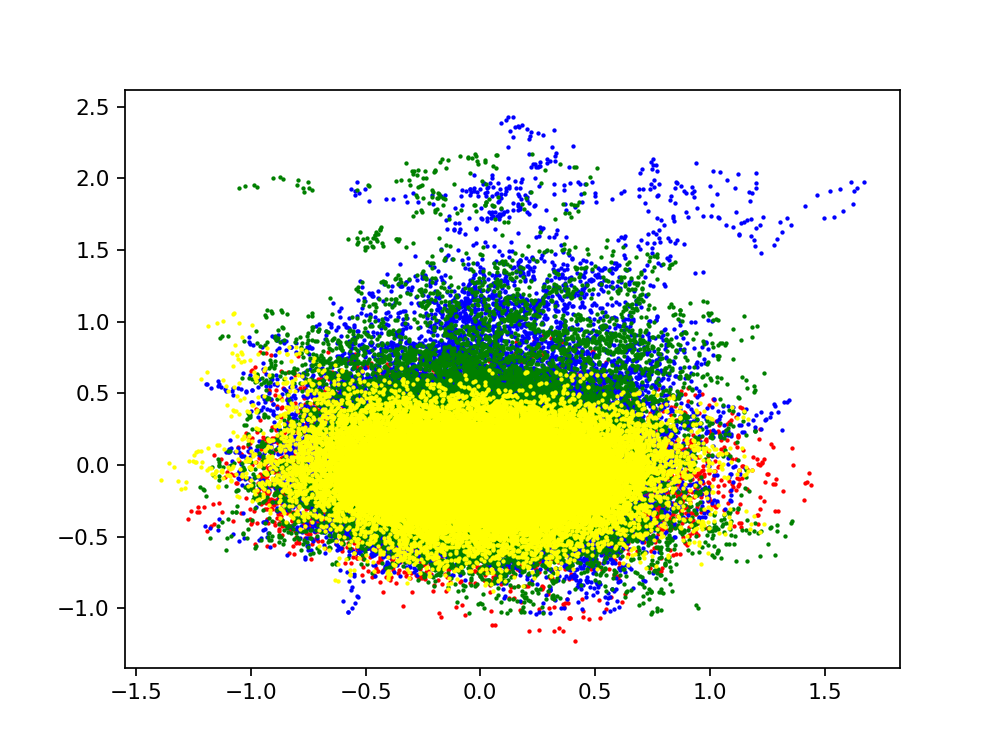

In [135]:
# 2D plot of terrains
plt.figure()
plt.scatter(x=tile['PC1_2d'], y=tile['PC2_2d'], c='red', s=1)
plt.scatter(x=turf['PC1_2d'], y=turf['PC2_2d'], c='blue', s=1)
plt.scatter(x=carp['PC1_2d'], y=carp['PC2_2d'], c='green', s=1)
plt.scatter(x=arcTile['PC1_2d'], y=arcTile['PC2_2d'], c='yellow', s=1)

In [136]:
if doKMeans:
    # matplotlib for 2D plotting of clusters
    plt.figure()
    plt.scatter(x=c0['PC1_2d'], y=c0['PC2_2d'], c='red', s=1)
    plt.scatter(x=c1['PC1_2d'], y=c1['PC2_2d'], c='blue', s=1)
    plt.scatter(x=c2['PC1_2d'], y=c2['PC2_2d'], c='green', s=1)
    plt.scatter(x=c3['PC1_2d'], y=c3['PC2_2d'], c='yellow', s=1)
    # plt.scatter(x=c4['PC1_2d'], y=c4['PC2_2d'], c='orange', s=1)
    # plt.scatter(x=c5['PC1_2d'], y=c5['PC2_2d'], c='brown', s=1)
    # plt.scatter(x=c6['PC1_2d'], y=c6['PC2_2d'], c='grey', s=1)
    # plt.scatter(x=c7['PC1_2d'], y=c7['PC2_2d'], c='purple', s=1)

In [137]:
init_notebook_mode(connected=True)

In [138]:
# plotly for interactive 3D plot of terrains
tilePlot = go.Scatter3d(x=tile['PC1_3d'], y=tile['PC2_3d'], z=tile['PC3_3d'],
               mode="markers", name="Tile",
               marker = dict(color = 'purple'),
               text=None)
turfPlot = go.Scatter3d(x=turf['PC1_3d'], y=turf['PC2_3d'], z=turf['PC3_3d'],
               mode="markers", name="Turf",
               marker = dict(color = 'brown'),
               text=None)
carpPlot = go.Scatter3d(x=carp['PC1_3d'], y=carp['PC2_3d'], z=carp['PC3_3d'],
               mode="markers", name="Carpet",
               marker = dict(color = 'green'),
               text=None)
arcTilePlot = go.Scatter3d(x=arcTile['PC1_3d'], y=arcTile['PC2_3d'], z=arcTile['PC3_3d'],
               mode="markers", name="ArcTile",
               marker = dict(color = 'red'),
               text=None)

plotData = [tilePlot, turfPlot, carpPlot, arcTilePlot]
title = "IMU Clustering Tile vs Turf vs Carpet vs Arc Tile"
layout = dict(title=title, xaxis=dict(title='PC1',ticklen= 5,zeroline= False), yaxis=dict(title= '',ticklen= 5,zeroline= False))

fig2=dict(data=plotData, layout=layout)

In [139]:
iplot(fig2)

In [140]:
if doKMeans:
    # plotly for interactive 3D plot of clusters
    t0 = go.Scatter3d(x=c0['PC1_3d'], y=c0['PC2_3d'], z=c0['PC3_3d'],
                   mode="markers", name="Cluster 0",
                   marker = dict(color = 'purple'),
                   text=None)
    t1 = go.Scatter3d(x=c1['PC1_3d'], y=c1['PC2_3d'], z=c1['PC3_3d'],
                   mode="markers", name="Cluster 1",
                   marker = dict(color = 'brown'),
                   text=None)
    t2 = go.Scatter3d(x=c2['PC1_3d'], y=c2['PC2_3d'], z=c2['PC3_3d'],
                   mode="markers", name="Cluster 2",
                   marker = dict(color = 'grey'),
                   text=None)
    t3 = go.Scatter3d(x=c3['PC1_3d'], y=c3['PC2_3d'], z=c3['PC3_3d'],
                   mode="markers", name="Cluster 3",
                   marker = dict(color = 'blue'),
                   text=None)
    # t4 = go.Scatter3d(x=c4['PC1_3d'], y=c4['PC2_3d'], z=c4['PC3_3d'],
    #                mode="markers", name="Cluster 4",
    #                marker = dict(color = 'green'),
    #                text=None)
    # t5 = go.Scatter3d(x=c5['PC1_3d'], y=c5['PC2_3d'], z=c5['PC3_3d'],
    #                mode="markers", name="Cluster 5",
    #                marker = dict(color = 'orange'),
    #                text=None)
    # t6 = go.Scatter3d(x=c6['PC1_3d'], y=c6['PC2_3d'], z=c6['PC3_3d'],
    #                mode="markers", name="Cluster 6",
    #                marker = dict(color = 'red'),
    #                text=None)
    # t7 = go.Scatter3d(x=c7['PC1_3d'], y=c7['PC2_3d'], z=c7['PC3_3d'],
    #                mode="markers", name="Cluster 7",
    #                marker = dict(color = 'yellow'),
    #                text=None)
    plotData = [t0, t1, t2, t3] #, t4, t5, t6, t7]
    title = "IMU Clustering with K-Means"
    layout = dict(title=title, xaxis=dict(title='PC1',ticklen= 5,zeroline= False), yaxis=dict(title= '',ticklen= 5,zeroline= False))

    fig=dict(data=plotData, layout=layout)

In [141]:
if doKMeans:
    iplot(fig)

In [142]:
def correlation_ratio(categories, measurements):
    fcat, _ = pd.factorize(categories)
    cat_num = np.max(fcat)+1
    y_avg_array = np.zeros(cat_num)
    n_array = np.zeros(cat_num)
    for i in range(0,cat_num):
        cat_measures = measurements[np.argwhere(fcat == i).flatten()]
        n_array[i] = len(cat_measures)
        y_avg_array[i] = np.average(cat_measures)
    y_total_avg = np.sum(np.multiply(y_avg_array,n_array))/np.sum(n_array)
    numerator = np.sum(np.multiply(n_array,np.power(np.subtract(y_avg_array,y_total_avg),2)))
    denominator = np.sum(np.power(np.subtract(measurements,y_total_avg),2))
    if numerator == 0:
        eta = 0.0
    else:
        eta = np.sqrt(numerator/denominator)
    return eta

In [ ]:
correlation_ratioation_ratio()